In [1]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from nltk.corpus import stopwords
from top2vec import Top2Vec

import sys
sys.path.insert(1,"../../midterm_election_semantics_2022/")
from helpers import clean_tweets

In [2]:
tweets = pd.read_excel("./data/authored_politician_tweets_11_2.xlsx")

In [3]:
tweets.head()

,id,tweet_url,created_at,parsed_created_at,user_screen_name,text,tweet_type,coordinates,hashtags,media,...,user_favourites_count,user_followers_count,user_friends_count,user_listed_count,user_location,user_name,user_statuses_count,user_time_zone,user_urls,user_verified
0,1587555261140582400,https://twitter.com/ChuckGrassley/status/15875...,Tue Nov 01 21:20:44 +0000 2022,2022-11-01T21:20:44+00:00,ChuckGrassley,Welcome 2Pres Biden’s America Farmers face hea...,original,NaN,NaN,NaN,...,5,760059,12645,6233,Iowa,Chuck Grassley,11838,NaN,http://grassley.senate.gov,True
1,1587518027553280000,https://twitter.com/ChuckGrassley/status/15875...,Tue Nov 01 18:52:47 +0000 2022,2022-11-01T18:52:47+00:00,ChuckGrassley,IRS scandals in past give us every reason to w...,original,NaN,NaN,NaN,...,5,760059,12645,6233,Iowa,Chuck Grassley,11838,NaN,http://grassley.senate.gov,True
2,1587508493044572165,https://twitter.com/ChuckGrassley/status/15875...,Tue Nov 01 18:14:53 +0000 2022,2022-11-01T18:14:53+00:00,ChuckGrassley,Q&amp;a w the Dubuque Rotary Club 37ppl issues...,original,NaN,99countymeetings,https://pbs.twimg.com/media/Fgf2iXjUUAA6Csm.jp...,...,5,760059,12645,6233,Iowa,Chuck Grassley,11838,NaN,http://grassley.senate.gov,True
3,1587477693972586498,https://twitter.com/ChuckGrassley/status/15874...,Tue Nov 01 16:12:30 +0000 2022,2022-11-01T16:12:30+00:00,ChuckGrassley,Dems gave IRS 80 billion dollars in their part...,original,NaN,NaN,NaN,...,5,760059,12645,6233,Iowa,Chuck Grassley,11838,NaN,http://grassley.senate.gov,True
4,1587471338385854464,https://twitter.com/ChuckGrassley/status/15874...,Tue Nov 01 15:47:15 +0000 2022,2022-11-01T15:47:15+00:00,ChuckGrassley,Celebrated the ribbon cutting of BAE Systems i...,original,NaN,NaN,https://pbs.twimg.com/media/FgfUw6iXEAACURa.jp...,...,5,760059,12645,6233,Iowa,Chuck Grassley,11838,NaN,http://grassley.senate.gov,True


In [4]:
tweets = clean_tweets(tweets)

../../midterm_election_semantics_2022\helpers.py:11: FutureWarning: The default value of regex will change from True to False in a future version.
  data['clean_text'] = data['clean_text'].str.replace('\d+', '')


In [5]:
# model = Top2Vec(list(tweets['clean_text']))
model = Top2Vec.load("../models/top2vec_11_1")

2022-11-02 14:06:05,163 - top2vec - INFO - Pre-processing documents for training
2022-11-02 14:06:17,908 - top2vec - INFO - Creating joint document/word embedding
2022-11-02 14:19:24,523 - top2vec - INFO - Creating lower dimension embedding of documents
2022-11-02 14:21:49,551 - top2vec - INFO - Finding dense areas of documents
2022-11-02 14:22:12,538 - top2vec - INFO - Finding topics


In [6]:
# model.save("../models/top2vec_11_1")

In [7]:
model.get_num_topics()

1744

In [8]:
topic_sizes, topic_nums = model.get_topic_sizes()

In [9]:
topic_sizes[0:10]

array([1742, 1229,  728,  718,  628,  625,  571,  571,  556,  533],
      dtype=int64)

In [10]:
topic_sizes[-10:]

array([27, 27, 26, 24, 24, 24, 24, 21, 21, 17], dtype=int64)

In [11]:
words, word_scores = model.similar_words(keywords=["student"], keywords_neg=[], num_words=10)
for word, score in zip(words, word_scores):
    print(f"{word} {score}")

loan 0.706065492683595
debt 0.6618422939388127
borrowers 0.6206616485847994
college 0.6000336794561176
students 0.5816125964295749
forgiveness 0.5532150926067962
education 0.5293602809691194
school 0.5048826074637193
loans 0.5012007168987775
relief 0.49451547870587653


# STUDENT LOAN TOPICS

This section uses keywords to identy topics related to student loans and affordable schooling. A subset of documents is used to identify if the topic is related to student loan forgiveness

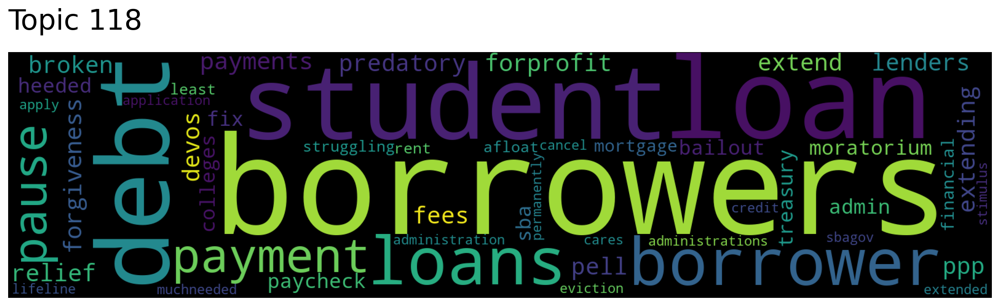

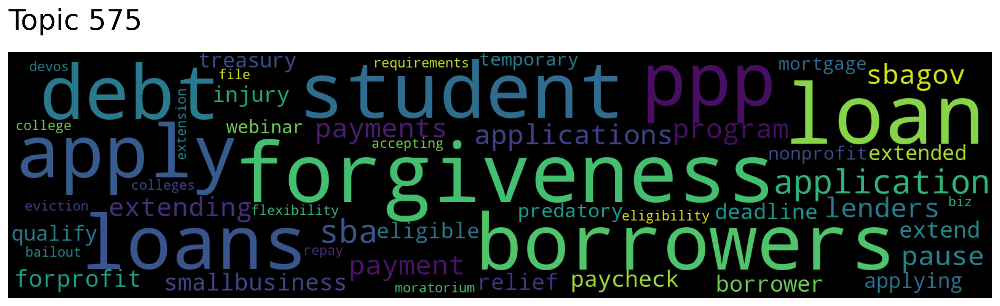

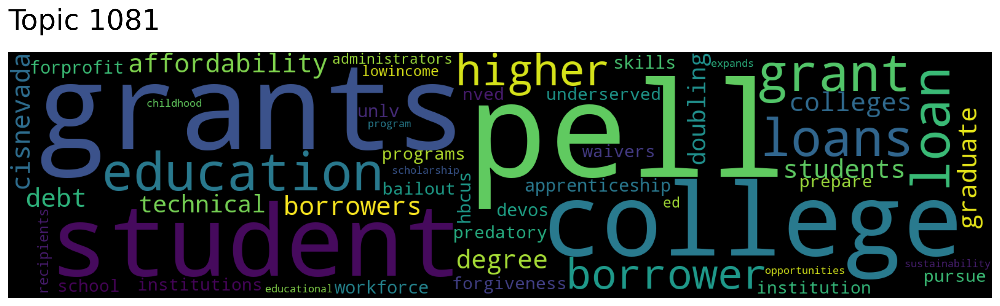

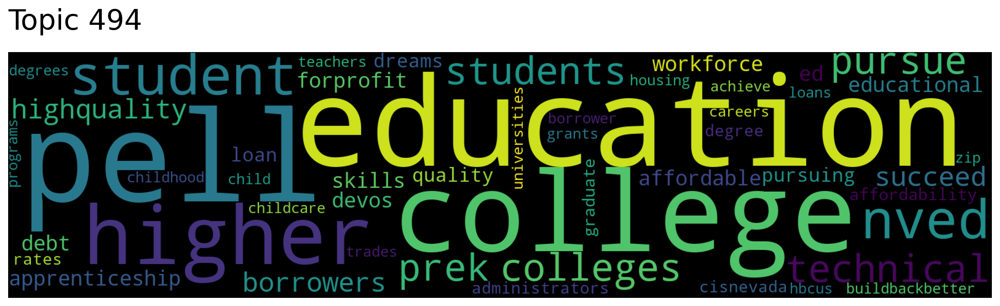

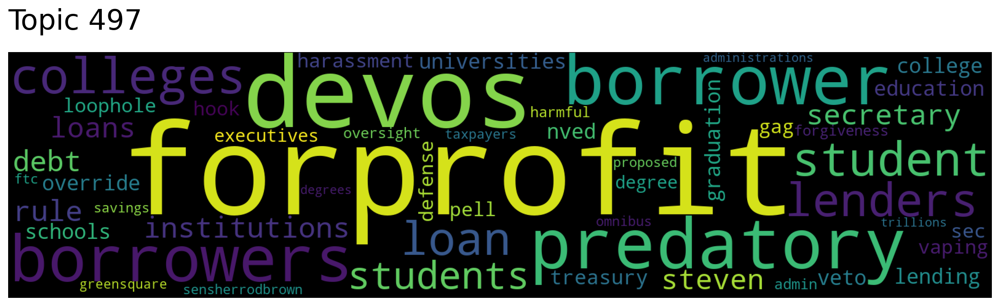

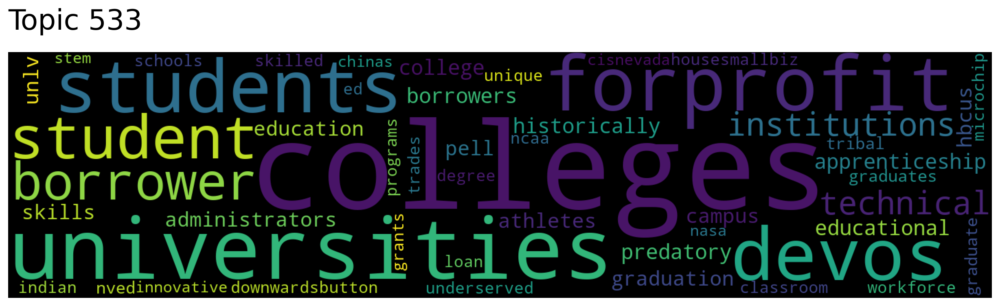

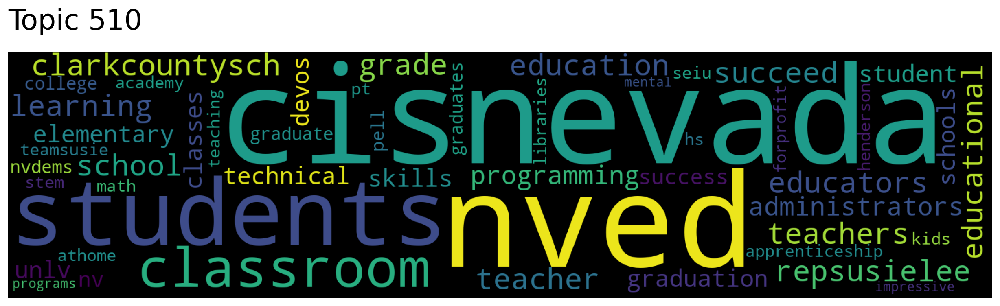

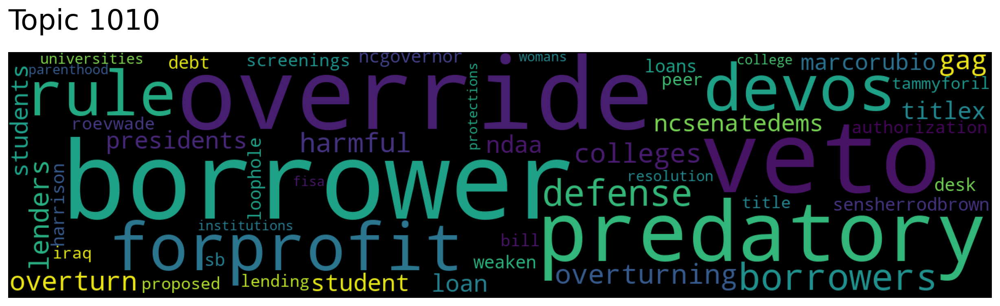

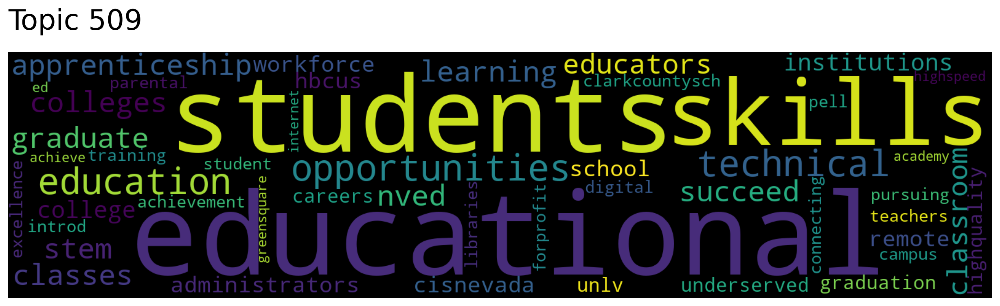

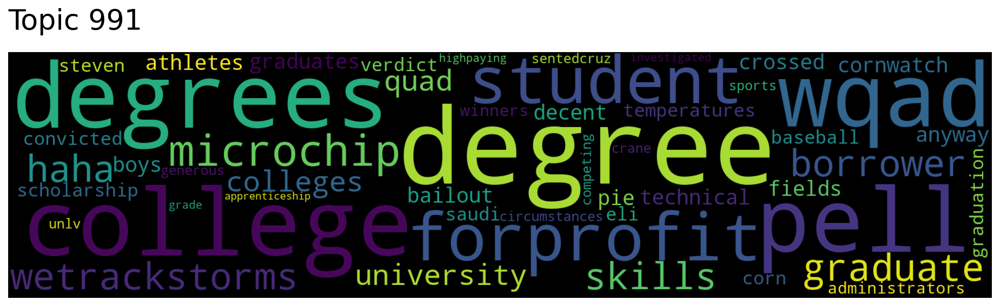

In [121]:
topic_words, word_scores, topic_scores, topic_nums = model.search_topics(keywords=["student","loan","students","college"], num_topics=10)
for topic in topic_nums:
    model.generate_topic_wordcloud(topic)

In [122]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[0], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 36677, Score: 0.8802270889282227
-----------
Im working to make sure student loan borrowers get needed relief during the coronavirus crisis 
-----------

Document: 38421, Score: 0.8694305419921875
-----------
Student loan borrowers deserve relief amp a fair workable system The Biden Admin should  checkmarkbutton extend student loan payment pause until at least   checkmarkbutton provide immediate relief by forgiving some debt for all borrowers  checkmarkbutton permanently fix our student loan system 
-----------

Document: 38263, Score: 0.8636009693145752
-----------
Im glad POTUS took action today to help struggling borrowers Ive outlined a clear plan to do more the Admin should forgive some debt for all borrowers and fix our student loan systemamp extend the pause until  so we can get it done Ill keep pushing 
-----------

Document: 38348, Score: 0.8629889488220215
-----------
Student loan borrowers are struggling with rising costs and need relief The Biden Administration sh

In [123]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[1], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 37501, Score: 0.827659010887146
-----------
See if youre eligible for relief through the Public Service Loan Forgiveness program ahead of the October  deadline here 
-----------

Document: 112561, Score: 0.7996842861175537
-----------
 womanraisinghand Im one of the  saying that its time to fix our public service loan forgiveness program  especially for our service members and veterans 
-----------

Document: 50375, Score: 0.796052873134613
-----------
The student loan forgiveness application is now LIVE  
-----------

Document: 112299, Score: 0.7675827741622925
-----------
We need to expand our student loan repayment and forgiveness programs  Americans are counting on it Thats why Im calling on SecCardona to do just that
-----------

Document: 37262, Score: 0.7597726583480835
-----------
The Biden Admin has made it easier for WAs public servantslike teachers amp firefightersto get the student debt relief they deserve through the Public Service Loan Forgiveness waiver Right n

In [124]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[2], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 4625, Score: 0.866392970085144
-----------
Pell Grants helped me get through college Its also time to increase access to Pell Grants amp lower student loan rates
-----------

Document: 37782, Score: 0.8375595808029175
-----------
My siblings amp I were able to go to college and graduate thanks to federal grants amp student loansso I know what a difference support like Pell Grants can make On its th anniversary Im working to increase Pell Grants so it can help even more students and families
-----------

Document: 69348, Score: 0.8329117298126221
-----------
Happy birthday Pell Grant For  years USEdGovs Pell Grant has transformed lives and expanded access to higher education for students in need Pell Grants helped me pay for college too and thats why Im fighting to increase their funding to keep up with costs 
-----------

Document: 39959, Score: 0.8173824548721313
-----------
Thanks to Pell Grants I was able to graduate from wsubut todays students are being asked to pay more 

In [125]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[3], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 37799, Score: 0.7829813957214355
-----------
Every Washington state student should be able to afford a quality higher education
-----------

Document: 40091, Score: 0.7625032663345337
-----------
We know that even before this pandemic higher education was out of reach for so many Im working to make higher education more affordable and to address the problems that students face every day 
-----------

Document: 35422, Score: 0.7431201934814453
-----------
I am working hard to ensure every student can go to community college for free This is a huge step we can take right now to provide students with the tools they need to pursue higher education and workforce training without living in debt
-----------

Document: 37339, Score: 0.7337564826011658
-----------
No one should have to give up the opportunity to pursue a higher education because they cant find or afford child care These funds are going to help many student parents in Washington state get the care they need 
----------

In [126]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[4], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 36838, Score: 0.9025171995162964
-----------
Its time for Secretary DeVos to stand with our students instead of greedy forprofit schools 
-----------

Document: 36829, Score: 0.8614928722381592
-----------
Secretary DeVos and the Department of Education are standing with the shady forprofit colleges rather than the students who have been defrauded Its time for Congress to put a stop to this 
-----------

Document: 36913, Score: 0.8504326343536377
-----------
Once again Secretary DeVos is failing at the most basic part of her job which is standing with students Im going to keep calling on her to finally hold student loan companies and forprofit colleges accountable for ripping off our students 
-----------

Document: 36869, Score: 0.8490389585494995
-----------
Im calling on Secretary DeVos to do her job amp finally stand with students who were defrauded by predatory forprofit schools Our students need a Dept of Education that will fight to protect them 
-----------

Document:

In [127]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[7], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 72089, Score: 0.923974871635437
-----------
Its just not right   Its time for Congress to override the Presidents veto of my bill overturning BetsyDeVosEDs harmful Borrower Defense Rule 
-----------

Document: 72031, Score: 0.8865934610366821
-----------
On Friday the House failed to override the Presidents veto of my bill overturning BetsyDeVoss Borrower Defense rule  To our struggling students veterans amp Americans defrauded by predatory schools this isnt the end of the road  Keep fighting  
-----------

Document: 72059, Score: 0.8623108863830566
-----------
If Betsy DeVos and this administration wont protect students and veterans from fraud Congress will   To my colleagues vote tomorrow to override the Presidents veto of my Borrower Defense bill 
-----------

Document: 72224, Score: 0.8572598099708557
-----------
My statement on President Trumps veto of my bipartisan bill to overturn BetsyDeVosEDs harmful  Borrower Defense rule The fight for our students and veterans is f

In [128]:
stu_lo_topics = list(topic_nums[0:5])
stu_lo_topics.append(topic_nums[7])
stu_lo_topics

[118, 575, 1081, 494, 497, 1010]

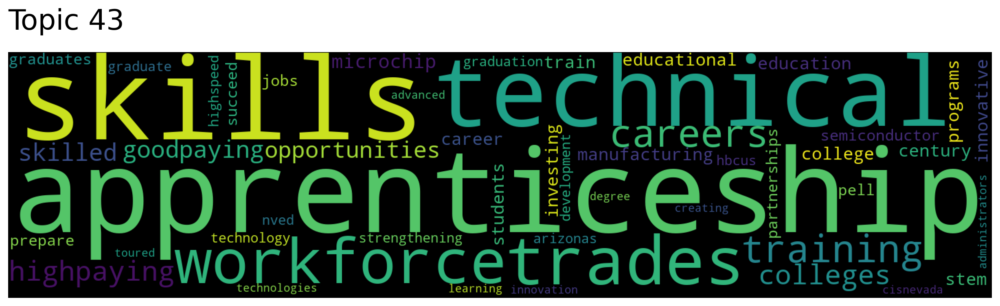

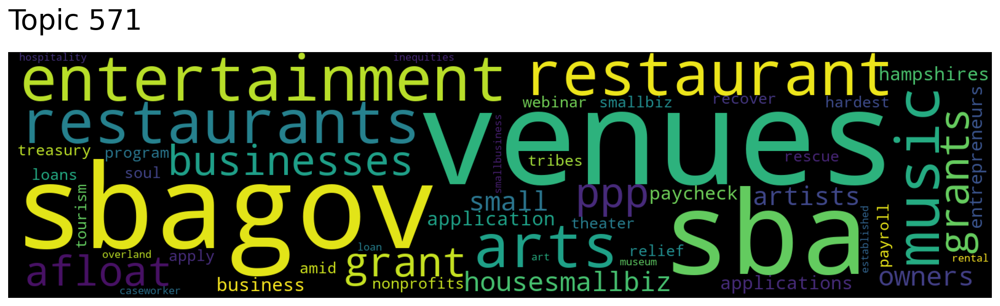

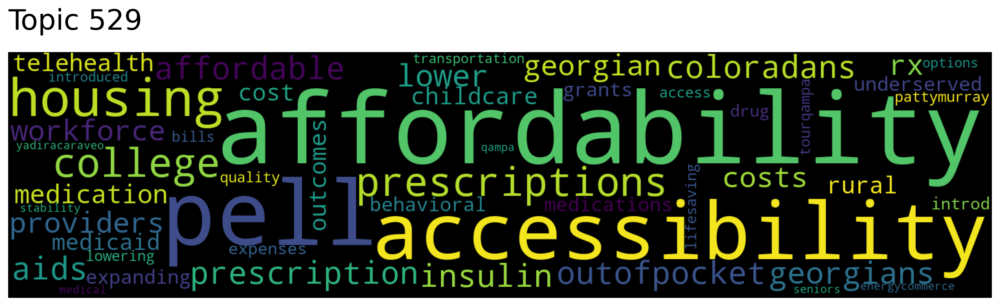

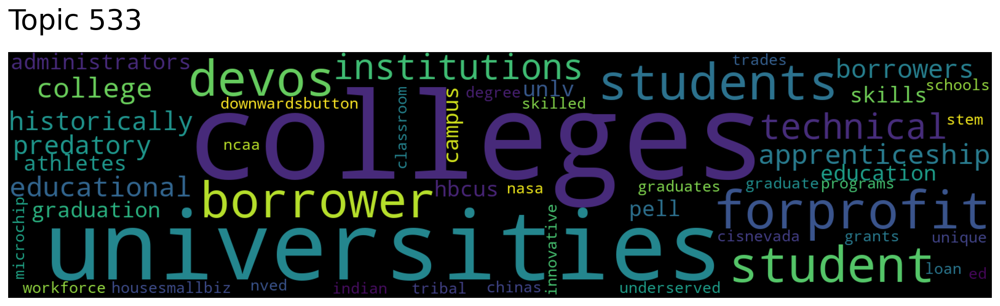

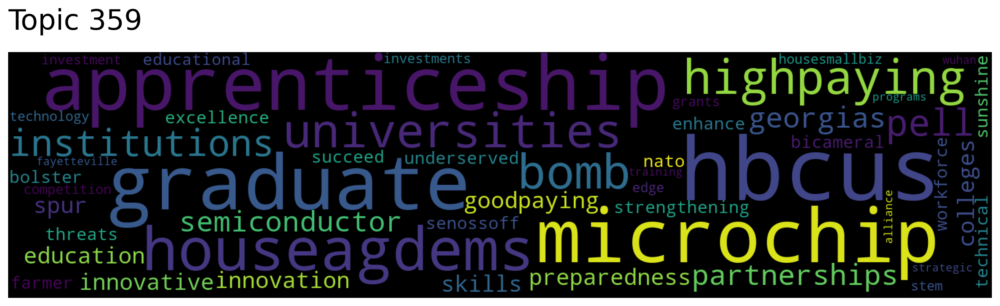

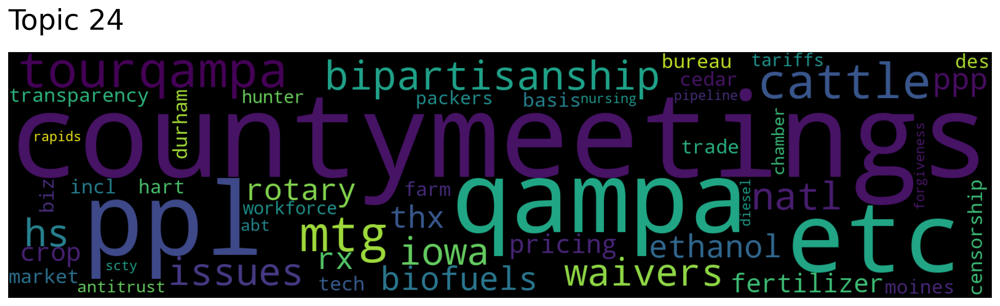

In [129]:
topic_words_2, word_scores_2, topic_scores_2, topic_nums_2 = model.search_topics(keywords=["pell", "grant"], num_topics=10)
for topic in topic_nums_2:
    if topic not in stu_lo_topics:
        model.generate_topic_wordcloud(topic)

In [130]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=533, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 82768, Score: 0.7896410822868347
-----------
Always great to visit my alma mater JCCCtweet  especially when Im there to welcome back the hardworking faculty and staff  The AmericanRescuePlan is helping students colleges and universities in our community get back on track 
-----------

Document: 113873, Score: 0.7782859802246094
-----------
Today I spoke to New Hampshire higher education leaders about the unprecedented challenges theyre facing this fall Ill continue to push for additional federal guidance and support for students colleges and universities 
-----------

Document: 139059, Score: 0.7763723731040955
-----------
Glad to announce that due to the American Rescue Plan Florida colleges and Universities have received nearly  billion in funding to help students stay in school and keep staff and students safe
-----------

Document: 136565, Score: 0.7724051475524902
-----------
Its College Colors Day Georgia is home to some of the very best colleges universities and trade 

In [131]:
stu_lo_topics.append(533)

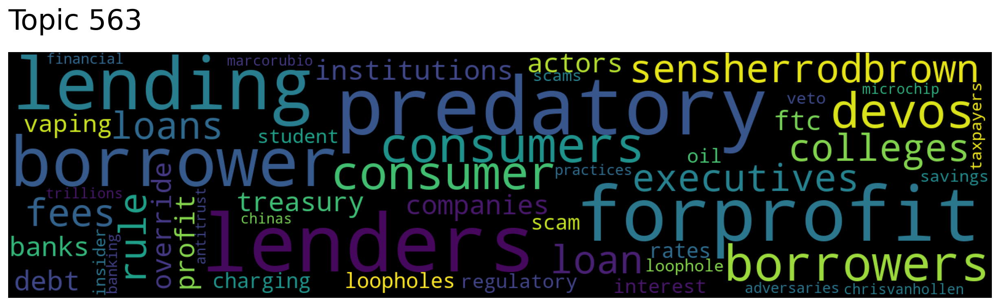

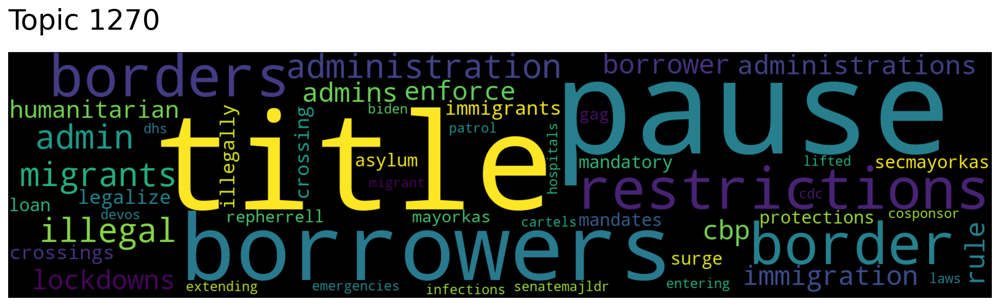

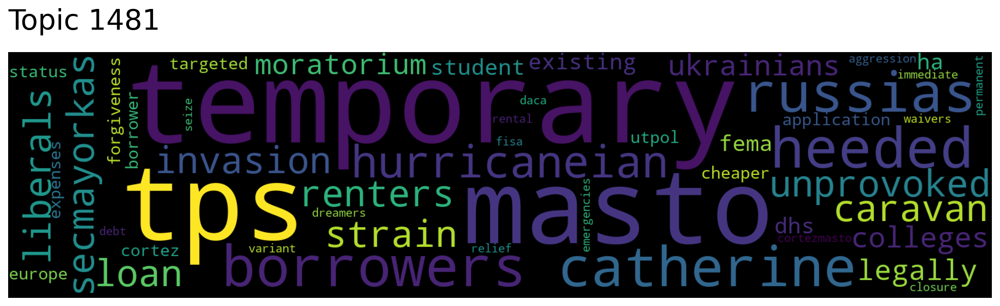

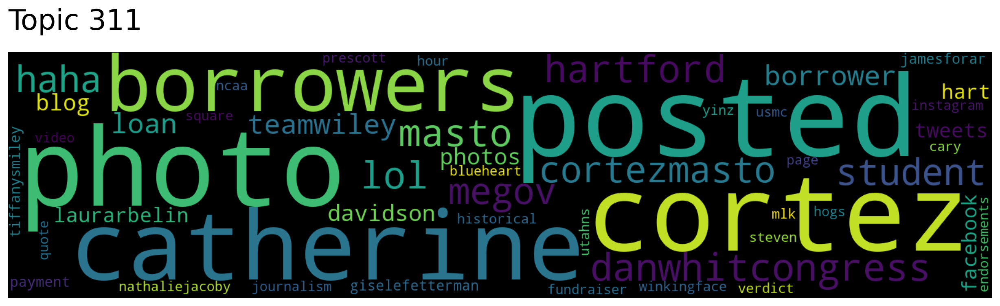

In [132]:
topic_words_2, word_scores_2, topic_scores_2, topic_nums_2 = model.search_topics(keywords=["borrowers"], num_topics=10)
for topic in topic_nums_2:
    if topic not in stu_lo_topics:
        model.generate_topic_wordcloud(topic)

In [133]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=563, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 4409, Score: 0.8091826438903809
-----------
I was proud to lead the fight against a GOPled effort to delay protections that keep predatory lenders from preying on military families
-----------

Document: 4453, Score: 0.7943872809410095
-----------
Join me amp votevets protect military families from predatory lending 
-----------

Document: 11975, Score: 0.7856422662734985
-----------
American consumers deserve protections that work for them  not predatory lenders Today POTUS signed my bill w SenSherrodBrown to strike down a Trump rule that helped abusive lenders scam consumers I vowed to fight against this rule from day  Today we delivered 
-----------

Document: 3796, Score: 0.7844098806381226
-----------
NRSC MarkKirk I stopped your fellow Republicans frm gutting predatory loan protections  Vets TammyStandsVets 
-----------

Document: 4293, Score: 0.7793020009994507
-----------
Great new update on our work to protect military families from predatory lending 
-----------



# Climate Change Topics

This section uses keywords to identy topics related to climate change. A subset of documents is used to identify if the topic is related to climate change

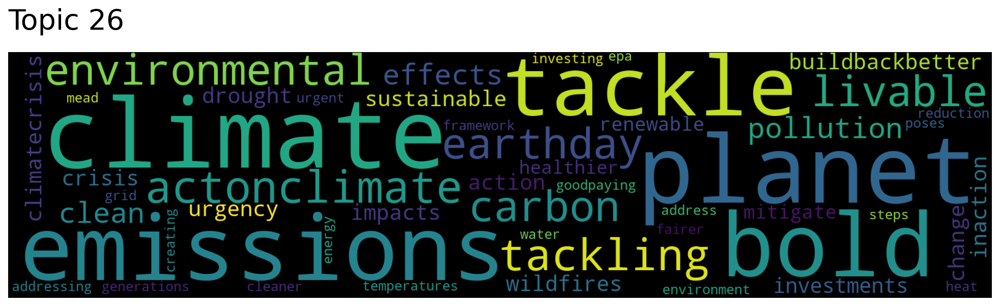

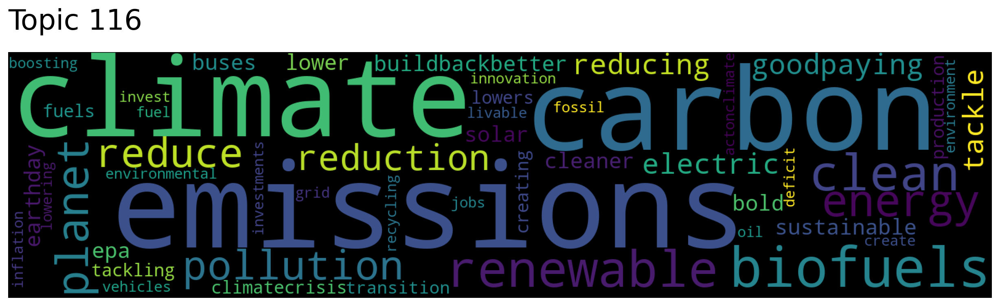

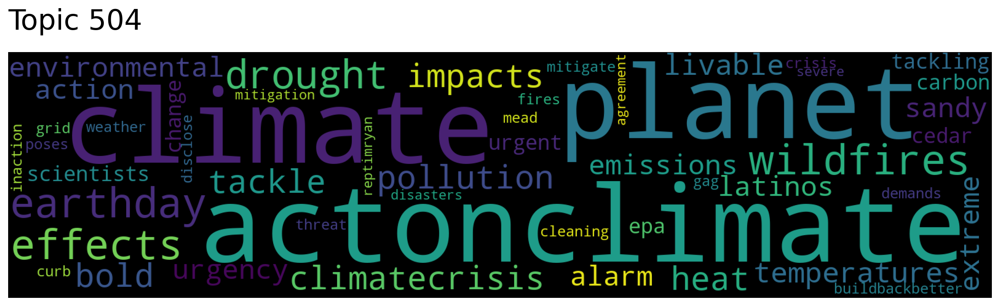

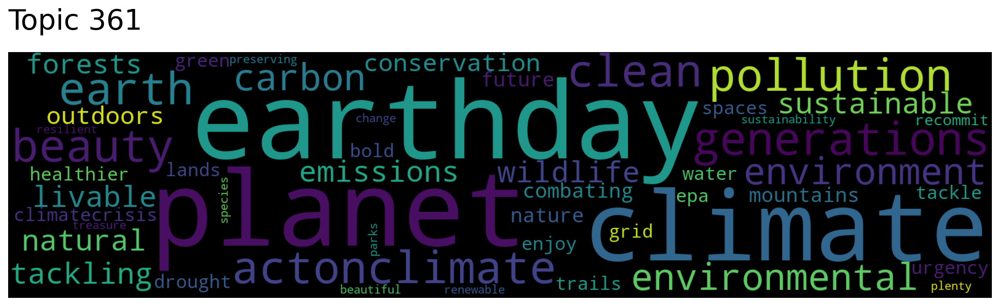

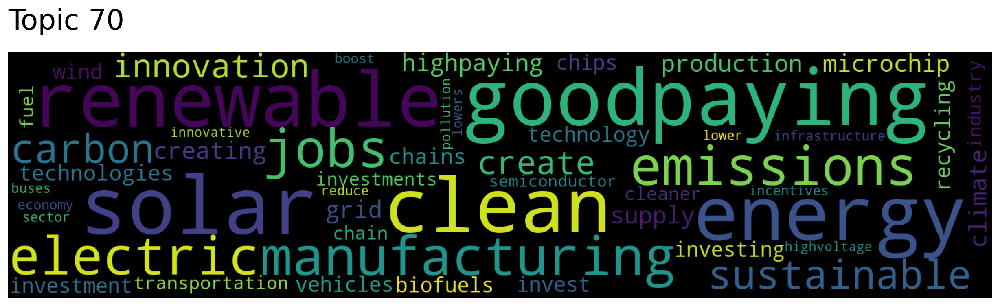

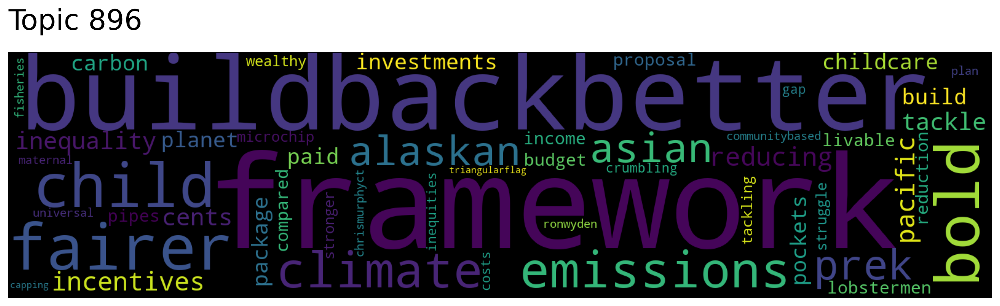

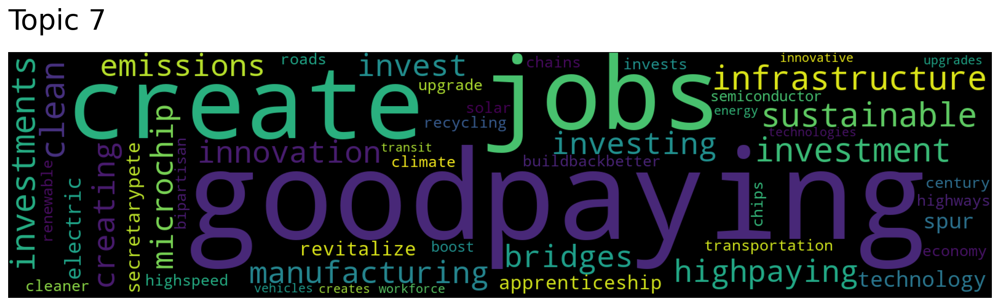

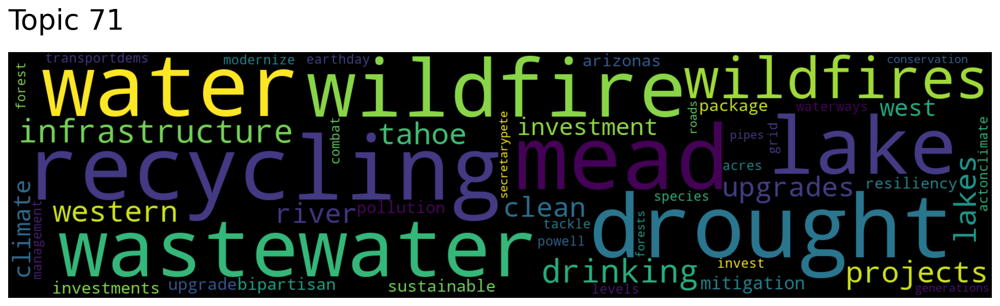

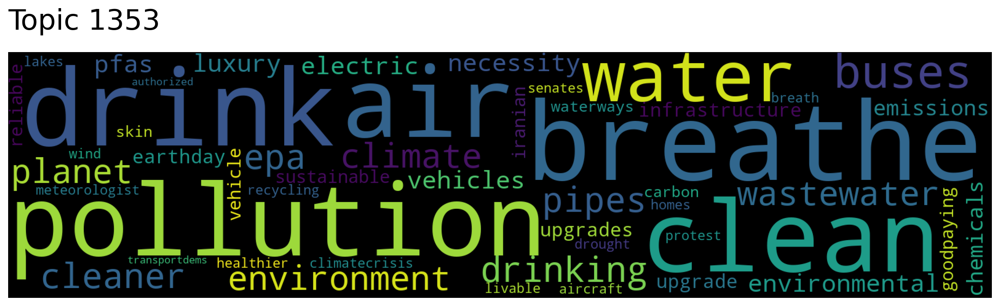

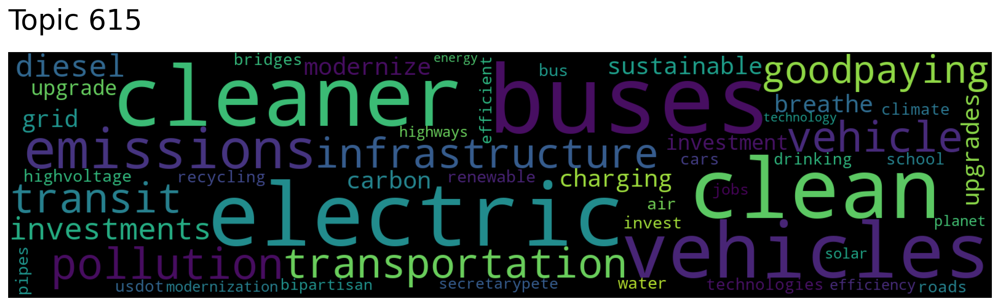

In [134]:
topic_words, word_scores, topic_scores, topic_nums = model.search_topics(keywords=["climate","change"], num_topics=10)
for topic in topic_nums:
    model.generate_topic_wordcloud(topic)

In [135]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[0], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 35001, Score: 0.7408009767532349
-----------
People in Washington state experience the impacts of the climate crisis almost every single day BuildBackBetter will take the bold action we need to finally address climate change and protect our planet for the future
-----------

Document: 35304, Score: 0.723838210105896
-----------
The climate crisis is already having devastating impacts on children families and communities of color all over the world I pushed for climate action in our infrastructure billand Ill keep working to take bold actions to protect our planet  
-----------

Document: 38077, Score: 0.720556378364563
-----------
Everyone should care about the climate crisis This is something thats going to be devastating for all of usnow and in the future if we dont act  Republicans have got to follow the science and take the bold action on climate that is needed to protect our planet
-----------

Document: 91496, Score: 0.716220498085022
-----------
Climate change is not c

In [136]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[1], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 37509, Score: 0.8397909998893738
-----------
The Inflation Reduction Act puts us on a path to lower our carbon emissions by  by  The US isnt just taking climate actionwere helping lead the fight 
-----------

Document: 38452, Score: 0.8370765447616577
-----------
Last year was a record year for harmful carbon dioxide emissions Weve got to lower carbon emissions and transition to clean energy ASAPand thats exactly what Im pushing for in the US Senate 
-----------

Document: 38586, Score: 0.8116531372070312
-----------
Reality check the climate crisis is here and now  Building a better future means taking action to address that crisislike investing in clean energy and cutting carbon emissions
-----------

Document: 39236, Score: 0.8109002113342285
-----------
We have to tackle the climate crisis headon That means lowering carbon emissions transitioning to clean energy and electrifying our nations vehiclesincluding school buses
-----------

Document: 34139, Score: 0.803762316703

In [137]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[2], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 70250, Score: 0.8986050486564636
-----------
Im in   The time to ActOnClimate is now 
-----------

Document: 35410, Score: 0.8647347092628479
-----------
The climate crisis is hereand we need big bold action to combat it ActOnClimate 
-----------

Document: 10512, Score: 0.8310409188270569
-----------
Goodnow lets do something constructive like expand economic opportunity StopGunViolence or ActOnClimate change 
-----------

Document: 35428, Score: 0.8275982141494751
-----------
The climate crisis is on our doorstep and urgent action simply cannot wait ActOnClimate 
-----------

Document: 37183, Score: 0.8208297491073608
-----------
Its time for Senate Republicans to stop delaying action to address the urgent climate crisis Families in Washington state across the country and around the world need us to ActOnClimate
-----------



In [138]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[3], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 89223, Score: 0.8311571478843689
-----------
EarthDay cant just be one day It needs to be every day 
-----------

Document: 112662, Score: 0.8234354257583618
-----------
Happy EarthDay    We only get one  globeshowingAmericas    So its on all of us to help protect it
-----------

Document: 3597, Score: 0.8225027918815613
-----------
Happy EarthDay Today lets rededicate ourselves to addressing climate change amp protecting our planet for future generations
-----------

Document: 55330, Score: 0.7990865707397461
-----------
Happy Earth Day everyone Im pledging to fight for our planet and fight for our future In Congress Ill support investments in clean energy sustainable transportation and programs that protect our ecosystems Will you join me EarthDay 
-----------

Document: 55326, Score: 0.7912555932998657
-----------
Happy Earth Day everyone Im pledging to fight for our planet and fight for our future In Congress Ill support investments in clean energy sustainable transportat

In [139]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[4], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 151497, Score: 0.8517123460769653
-----------
We need to ramp up renewable energy production I introduced a new bill to expand Americas solar manufacturing supply chain create goodpaying jobs and support our global competitiveness Nevada is a leader in solar and Ill keep working to promote our clean energy economy
-----------

Document: 139510, Score: 0.8070987462997437
-----------
My Reclaiming the Solar Supply Chain Act is moving forward as part of the new bipartisan America COMPETES Act of  
-----------

Document: 138689, Score: 0.7950913310050964
-----------
The AmericaCOMPETES Act establishes America as a global leader in solar manufacturing and production
-----------

Document: 140483, Score: 0.7859634757041931
-----------
NEW just introduced legislation to make longoverdue investments in USbased solar manufacturing create good new jobs and bring down the cost of renewable energy as we fight to slow down climate change  With USRepMikeDoyle RepDebDingell RepSlotkin  
---

In [140]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[5], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 39210, Score: 0.8899845480918884
-----------
Passing the BuildBackBetter framework soon is one of the best ways we can support Washington states working families
-----------

Document: 39220, Score: 0.8581165075302124
-----------
I joined ABCNewsLive to talk about the BuildBackBetter framework announced today Watch below 
-----------

Document: 39202, Score: 0.8557376265525818
-----------
The BuildBackBetter framework is historicand its going to make a real difference in peoples lives 
-----------

Document: 39145, Score: 0.8139142990112305
-----------
Democrats believe health care should be easier to get and more affordable thats why the BuildBackBetter framework will take needed steps to lower costs and expand health care coverage 
-----------

Document: 39176, Score: 0.7931275367736816
-----------
Its time to solve Americas child care crisis The BuildBackBetter framework which is based on my child care proposal is our chance to do so Lets get it passed   Read my oped in se

In [141]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[8], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 17318, Score: 0.9005179405212402
-----------
You deserve to breathe clean air and drink clean water
-----------

Document: 15893, Score: 0.8793947100639343
-----------
I believe every person deserves to drink clean water and breathe clean air
-----------

Document: 138808, Score: 0.8565731644630432
-----------
Clean air to breathe and clean water to drink should not be partisan
-----------

Document: 154764, Score: 0.8145014047622681
-----------
In the Senate I will fight for our planet and for clean air to breathe for every single person Help me get it done 
-----------

Document: 154768, Score: 0.7908671498298645
-----------
Clean air to breathe is a right not a privilege
-----------



In [142]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_nums[9], num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 35587, Score: 0.8475159406661987
-----------
Its time to invest in zeroemission transportation and electrify our nations school buses 
-----------

Document: 35600, Score: 0.8260682821273804
-----------
I am working in the Senate to invest in clean energy and electrify our nations school buses This legislation is good for the health of our students for the economy and for our climate 
-----------

Document: 39622, Score: 0.8214707374572754
-----------
Good news my Clean School Bus Act passed the Senate as part of the bipartisan infrastructure bill delivering thousands of electric school buses nationwide to help school districts buy clean Americanmade zero emission buses amp replace the yellow school bus fleet
-----------

Document: 37208, Score: 0.82066810131073
-----------
Thanks to my Clean School Buses Act that I passed in the Bipartisan Infrastructure Law school districts across Washington state are transitioning to electric school buses Moving away from dirty diesel buse

In [143]:
cli_cha_topics = list(topic_nums[0:5]) + list(topic_nums[8:10])
cli_cha_topics

[26, 116, 504, 361, 70, 1353, 615]

In [144]:
words, word_scores = model.similar_words(keywords=["climate","change"], keywords_neg=[], num_words=10)
for word, score in zip(words, word_scores):
    print(f"{word} {score}")

action 0.6706741061313162
bold 0.6567923050472392
tackle 0.6232943065738781
planet 0.6203791583147196
impacts 0.5940502740873423
real 0.589628948865337
environmental 0.5893160621053067
crisis 0.5875645761177293
emissions 0.5869470487157968
address 0.5826798638734484


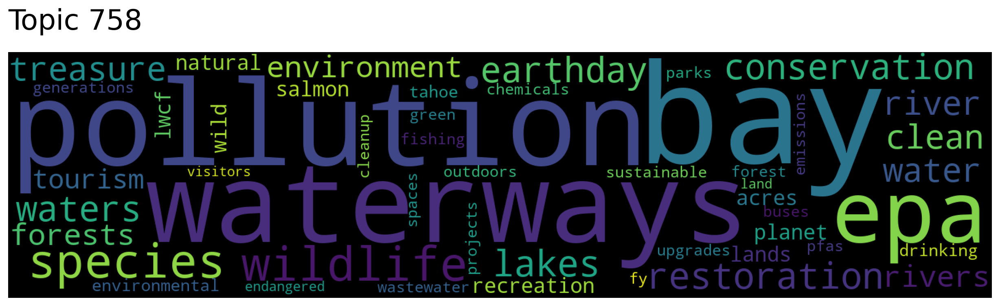

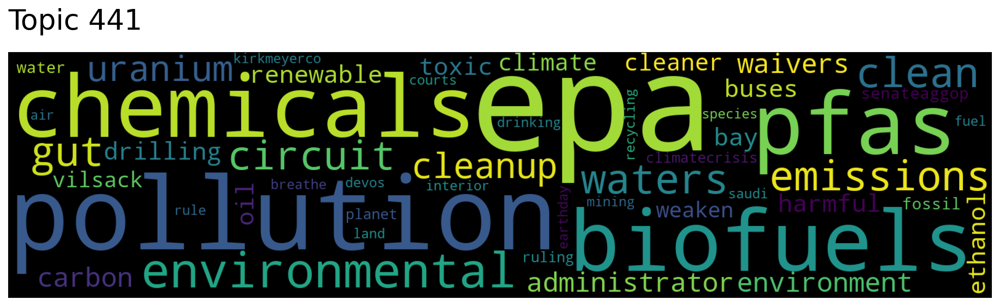

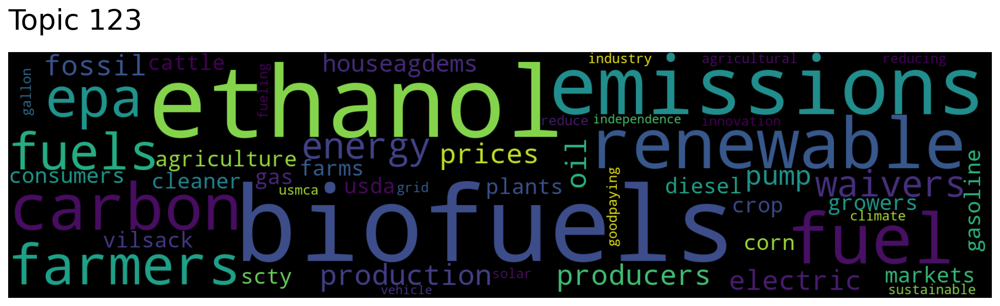

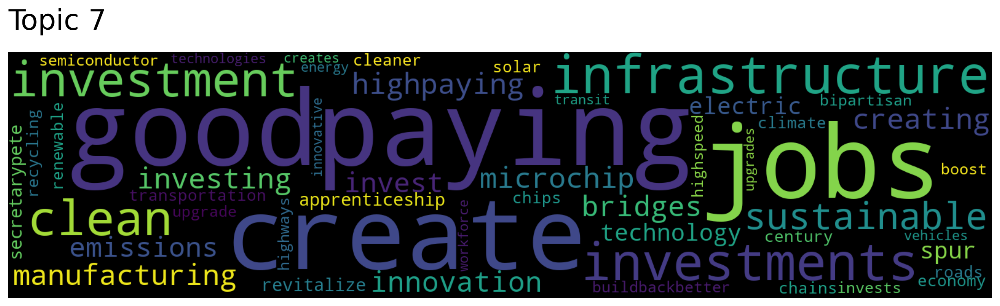

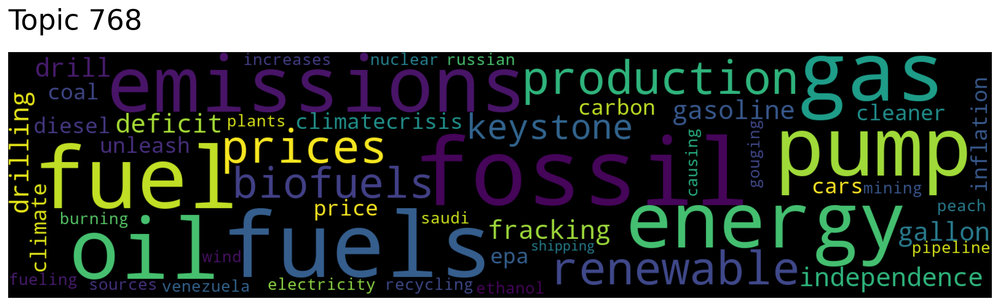

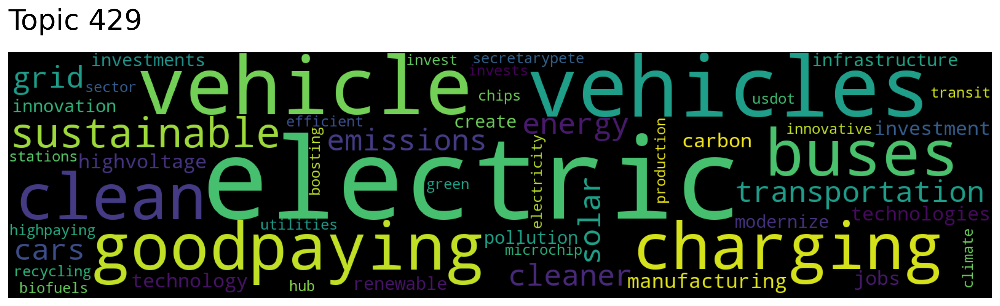

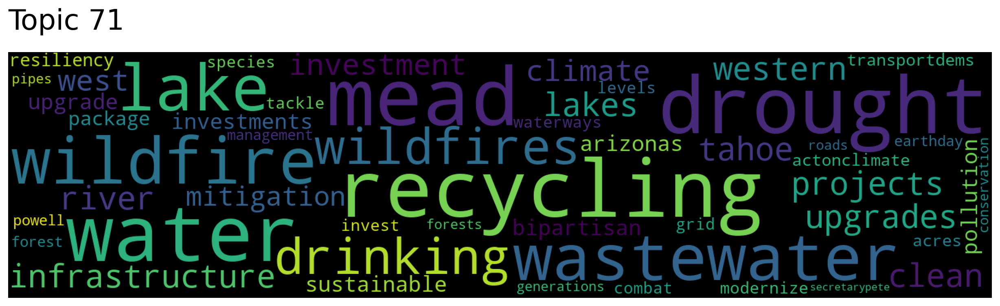

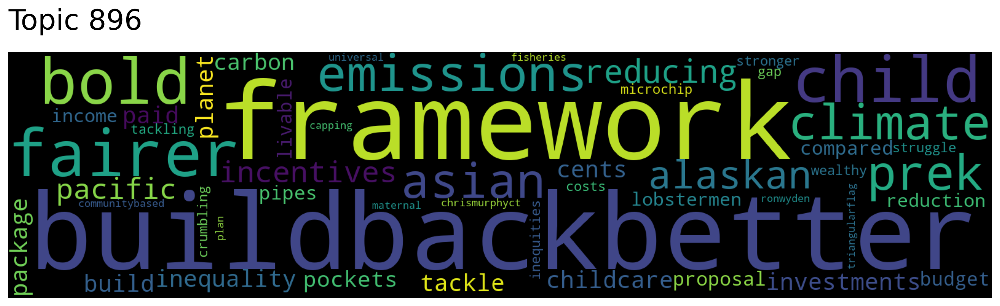

In [145]:
topic_words_2, word_scores_2, topic_scores_2, topic_nums_2 = model.search_topics(keywords=["planet","environmental","emissions"], num_topics=15)
for topic in topic_nums_2:
    if topic not in cli_cha_topics:
        model.generate_topic_wordcloud(topic)

In [146]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=758, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 13426, Score: 0.7824865579605103
-----------
Good news  Despite Trumps efforts to wipe it out we just secured additional funds for the EPAs Chesapeake Bay Program which boosts our Bay clean up funding by M this year for a total of M   This program is vital to ensuring the health of our Bay and economy
-----------

Document: 12656, Score: 0.7381479740142822
-----------
The EPA has failed to use its authority to ensure that all parties to the Chesapeake Bay Agreement meet their pollution reduction obligations so I applaud the Chesapeake Bay Foundation Maryland Watermens Association and state partners for taking legal action 
-----------

Document: 12021, Score: 0.733916699886322
-----------
Important move by POTUS National standards to protect our wetlands and marshes are vital to the health of our environment They are natural filters that help protect the vitality of waterbodies like our national treasure the Chesapeake Bay 
-----------

Document: 12206, Score: 0.7256354093551

In [147]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=441, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 77180, Score: 0.8983515501022339
-----------
EPA 
-----------

Document: 53979, Score: 0.8647621870040894
-----------
EPA Read more here 
-----------

Document: 107276, Score: 0.7235237956047058
-----------
Congratulations to AGScottPruitt on his confirmation to head the EPA He is the right man for the job 
-----------

Document: 93008, Score: 0.6937982439994812
-----------
The head of the EPA should always have been someone who believes in science and in protecting the air water and land of this country  ScottPruittOK used the EPA as a way to benefit himself and his oil and gas buddies byescott
-----------

Document: 107356, Score: 0.6916882991790771
-----------
Congrats to AGScottPruitt Strong pick by realDonaldTrump to lead EPA 
-----------



In [148]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=123, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 77738, Score: 0.7975343465805054
-----------
Proud to fight for family farmers and biofuels producers in MN today and every day 
-----------

Document: 78649, Score: 0.7737280130386353
-----------
It was great to meet with BiodieselMedia yesterday to talk about the bipartisan legislation RepFinkenauer and I introduced to promote biofuels and help our family farmers and our environment 
-----------

Document: 75081, Score: 0.7654041051864624
-----------
Im proud to have introduced this legislation to expand our market for biofuels which would help to stabilize our family farmers and provide more clean fuel to Americans 
-----------

Document: 77880, Score: 0.7601855993270874
-----------
Biofuels help family farmers create economic opportunity in rural communities and reduce carbon emissions from the transportation sector Renewable fuels can play an immediate role in our transition away from fossil fuels 
-----------

Document: 78259, Score: 0.7490335702896118
-----------
Thank

In [150]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=768, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 89309, Score: 0.8433098793029785
-----------
Transitioning away from fossil fuels is not a radical agenda IL
-----------

Document: 157916, Score: 0.8105661273002625
-----------
Under this administration theres a war on fossil fuels What happened to our bipartisan goal of energy independence These reckless Democrat policies are weakening America and the West 
-----------

Document: 108614, Score: 0.801694393157959
-----------
JoeBiden and SenatorHassan have been waging a war on fossil fuels since the day Democrats took control of Washington Ill support American energy production to make America energy independent 
-----------

Document: 156332, Score: 0.8001596927642822
-----------
and yet people will be more critical of a green new deal than fossil fuel infrastructure 
-----------

Document: 89044, Score: 0.7582719922065735
-----------
Russia needs to be held to account And that means continuing the embargo on their fossil fuels 
-----------



In [151]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=429, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 151907, Score: 0.8439304828643799
-----------
Ive been working to promote electric vehicles fight climate change and create goodpaying jobs in Nevadas growing clean energy industry Glad the administration is pushing to electrify our mail trucks and Ill keep doing everything I can for EVs in the Senate 
-----------

Document: 153167, Score: 0.7946105599403381
-----------
Read more about how my bills which are part of my InnovationState Initiative will support and promote electric vehicles and the infrastructure that supports them  downarrow  
-----------

Document: 152766, Score: 0.7747827172279358
-----------
All communities should have access to clean transportation technology Im working to promote Electric Vehicles because theyll create goodpaying green jobs and put us on a path to a more sustainable future
-----------

Document: 152166, Score: 0.764751136302948
-----------
Electric vehicles will help us combat climate change and support goodpaying jobs in Nevada and across

In [152]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=71, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 66463, Score: 0.8616265654563904
-----------
Nevadans rely on Lake Mead for water but due to the climate crisis it sits at alarmingly low levels  My water recycling bill included in the Bipartisan Infrastructure Bill will create an infrastructure for drought resiliency for generations to come 
-----------

Document: 69227, Score: 0.8583665490150452
-----------
The House passed my legislation to tackle our drought invest in new western water infrastructure and keep more water in Lake Mead for Nevadans Read more 
-----------

Document: 69682, Score: 0.8515461087226868
-----------
The Colorado River provides for states across the west We must work together to conserve amp find new water solutions  Im proud to have secured legislation in the Bipartisan Infrastructure Law to expand water recycling amp keep more water in Lake mead for Nevadans 
-----------

Document: 69269, Score: 0.8465261459350586
-----------
Las Vegas is growing Lake Mead is shrinking  We need to get serious abo

In [153]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=896, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 39210, Score: 0.8899845480918884
-----------
Passing the BuildBackBetter framework soon is one of the best ways we can support Washington states working families
-----------

Document: 39220, Score: 0.8581165075302124
-----------
I joined ABCNewsLive to talk about the BuildBackBetter framework announced today Watch below 
-----------

Document: 39202, Score: 0.8557376265525818
-----------
The BuildBackBetter framework is historicand its going to make a real difference in peoples lives 
-----------

Document: 39145, Score: 0.8139142990112305
-----------
Democrats believe health care should be easier to get and more affordable thats why the BuildBackBetter framework will take needed steps to lower costs and expand health care coverage 
-----------

Document: 39176, Score: 0.7931275367736816
-----------
Its time to solve Americas child care crisis The BuildBackBetter framework which is based on my child care proposal is our chance to do so Lets get it passed   Read my oped in se

In [155]:
cli_cha_topics += [758, 441, 123, 768, 429, 71, 896]

In [156]:
cli_cha_topics

[26, 116, 504, 361, 70, 1353, 615, 758, 441, 123, 768, 429, 71, 896]

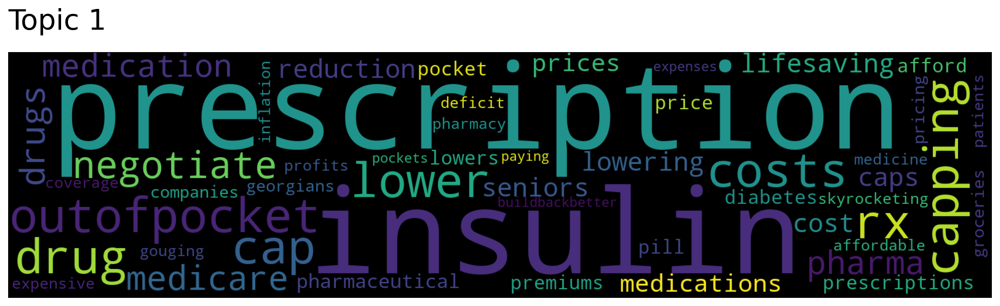

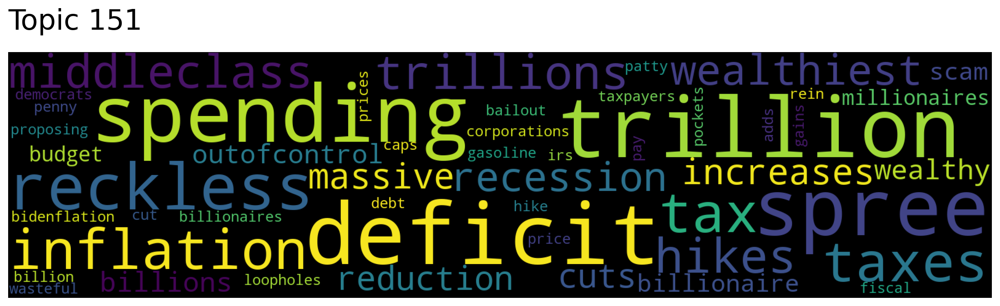

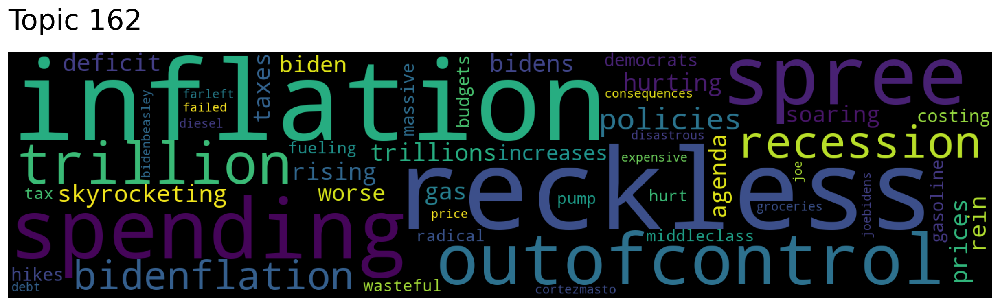

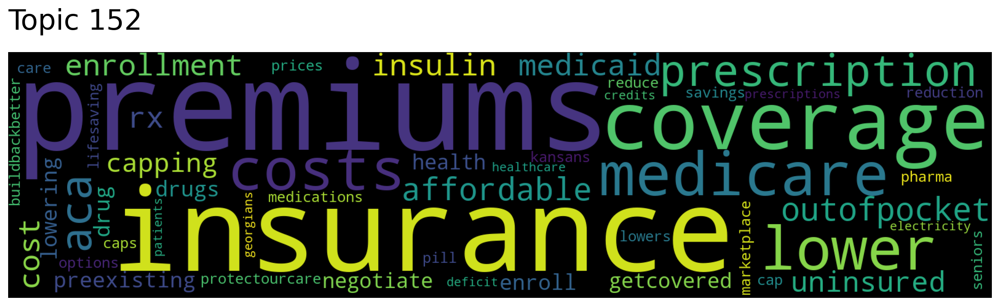

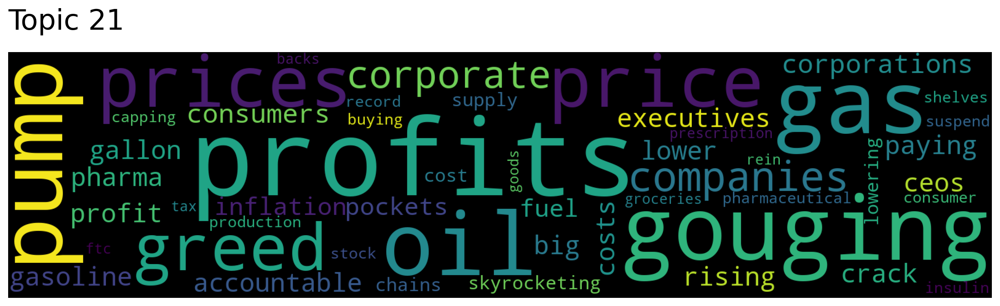

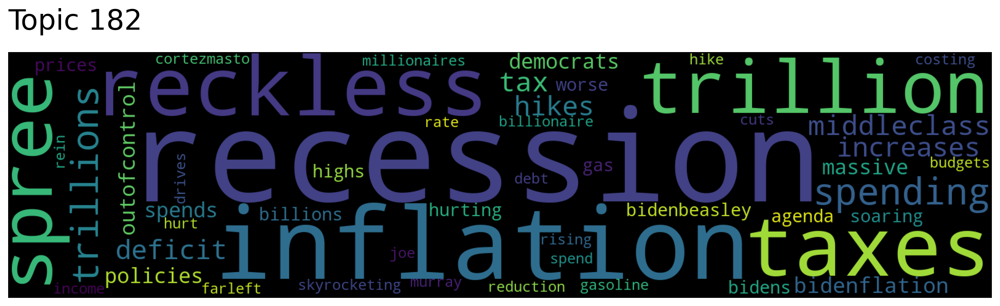

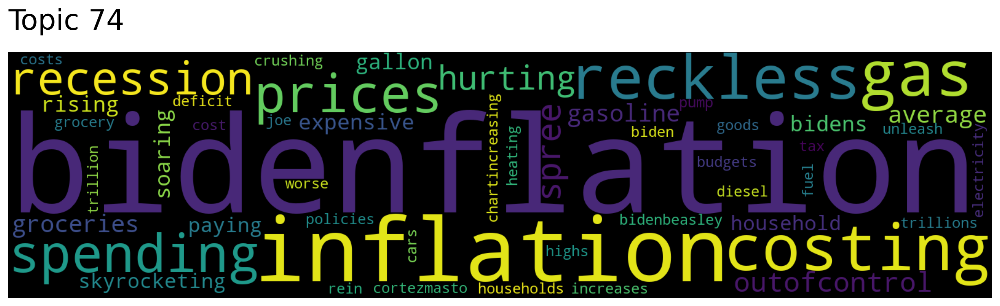

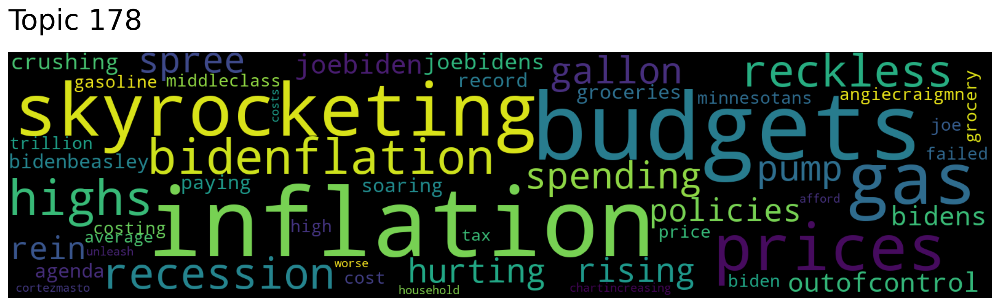

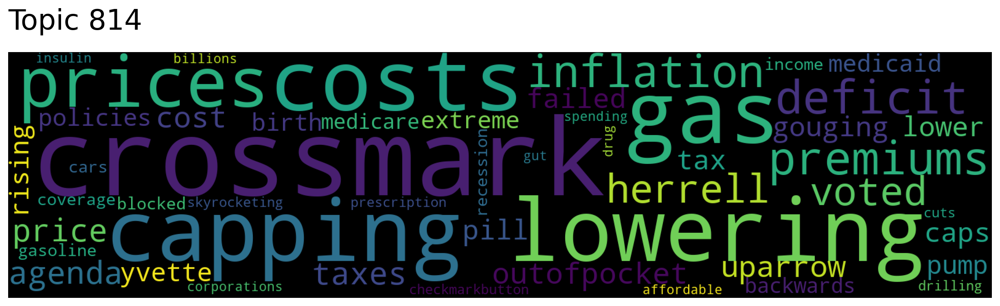

In [157]:
topic_words_2, word_scores_2, topic_scores_2, topic_nums_2 = model.search_topics(keywords=["inflation","reduction","act"], num_topics=10)
for topic in topic_nums_2:
    if topic not in cli_cha_topics:
        model.generate_topic_wordcloud(topic)

In [158]:
documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=1, num_docs=5)
for doc, score, doc_id in zip(documents, document_scores, document_ids):
    print(f"Document: {doc_id}, Score: {score}")
    print("-----------")
    print(doc)
    print("-----------")
    print()

Document: 77056, Score: 0.8057743906974792
-----------
No one should have to ration a lifesustaining drug because they cant afford it These flaws are exactly why I support legislation to reduce the cost of insulin cap outofpocket spending for seniors and allow Medicare to negotiate drug prices 
-----------

Document: 34748, Score: 0.8037415742874146
-----------
Im working to lower costs for seniors and patients in Washington state by allowing Medicare to negotiate lower prices on prescription drugs and capping the cost of lifesaving drugs like insulin
-----------

Document: 69608, Score: 0.7911666631698608
-----------
Its time to lower drug costs Seniors are struggling  Ive got a bill to lower their costs
-----------

Document: 37481, Score: 0.7910255789756775
-----------
Lifesaving drugs dont do any good if you cant afford them Ive been fighting to bring down costs for patients for years With the Inflation Reduction Act were delivering by capping outofpocket drug costs for seniors and

# PARSING THE DOCS

This section uses the identified topics to sperate out tweets related to our topics

In [163]:
model.documents[1]

'IRS scandals in past give us every reason to worry about how tax collectors will use their massive amt of cash Dems gave in partisan spending bill The people need to have transparency amp accountability ThuneGrassley bill will mandate that  impose penalties if IRS doesnt comply'

In [162]:
tweets['clean_text'][1]

'IRS scandals in past give us every reason to worry about how tax collectors will use their massive amt of cash Dems gave in partisan spending bill The people need to have transparency amp accountability ThuneGrassley bill will mandate that  impose penalties if IRS doesnt comply'

In [173]:
tweets['topic_id'] = model.get_documents_topics(doc_ids = model.document_ids)[0]

In [178]:
climate_tweets = tweets.loc[tweets['topic_id'].isin(cli_cha_topics)]

In [180]:
len(climate_tweets)

1924

In [181]:
loan_tweets = tweets.loc[tweets['topic_id'].isin(stu_lo_topics)]

In [182]:
len(loan_tweets)

673

In [183]:
climate_tweets.to_csv("./data/climate_tweets_11_1.csv")

In [184]:
loan_tweets.to_csv("./data/loan_tweets_11_1.csv")